<a href="https://colab.research.google.com/github/easyri/splines/blob/main/c%2B%2B/image_error.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [28]:
from skimage.metrics import structural_similarity
import cv2
import numpy as np
from PIL import Image
from google.colab.patches import cv2_imshow

orig_im = cv2.imread('/content/drive/MyDrive/splines/vincent-van-gogh_road-with-cypresses-1890.jpg')
linear_spline = cv2.imread('/content/drive/MyDrive/splines/parallel_linear.jpg')
square_spline = cv2.imread('/content/drive/MyDrive/splines/parallel_square.jpg')

# structural_similarity returns a score and a difference image, diff
# The score represents the structural similarity index between the two input images
# and can fall between the range [-1,1] with values closer to one representing higher similarity.

score_linear, diff_linear = structural_similarity(orig_im, linear_spline, multichannel=True, full=True) 
score_square, diff_square = structural_similarity(orig_im, square_spline, multichannel=True, full=True)
score_errors, diff_errors = structural_similarity(linear_spline, square_spline, multichannel=True, full=True)
diff_linear = (diff_linear*255).astype('uint8')
diff_square = (diff_square*255).astype('uint8')
diff_errors = (diff_errors*255).astype('uint8')
frame = cv2.hconcat((diff_linear, diff_square))
print('linear score = ', score_linear)
print('square score = ', score_square)
print('similarity splines score', score_errors)







linear score =  0.8068814003917787
square score =  0.7379497735469834
similarity splines score 0.8256119148093042


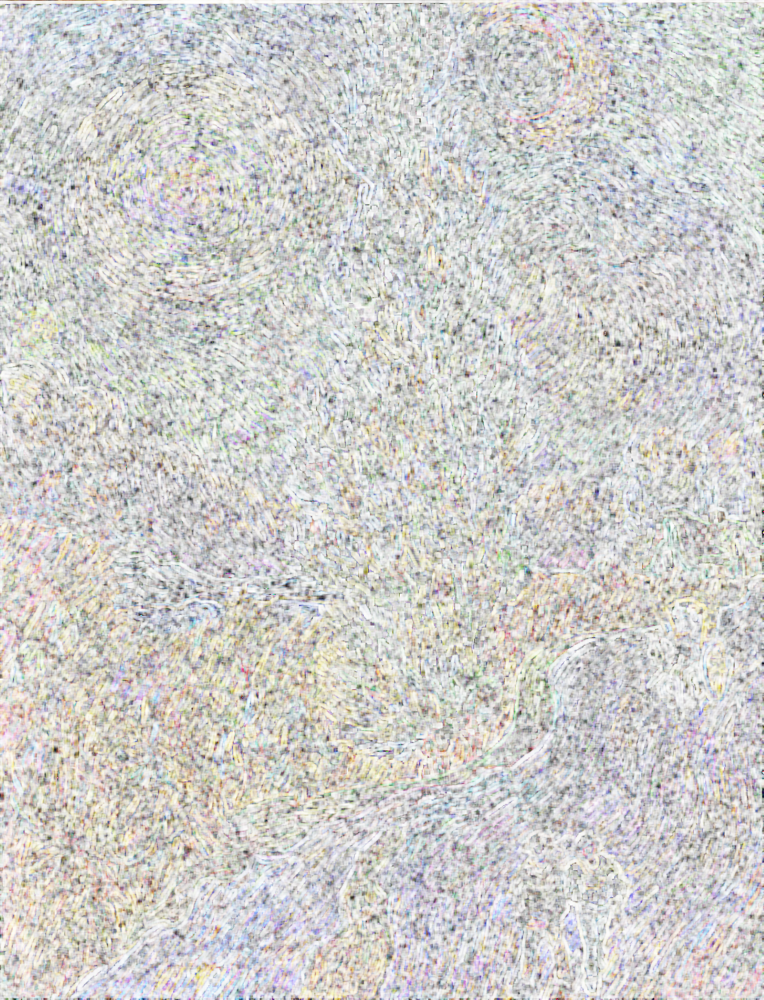

In [23]:
cv2_imshow(diff_linear) # linear_spline

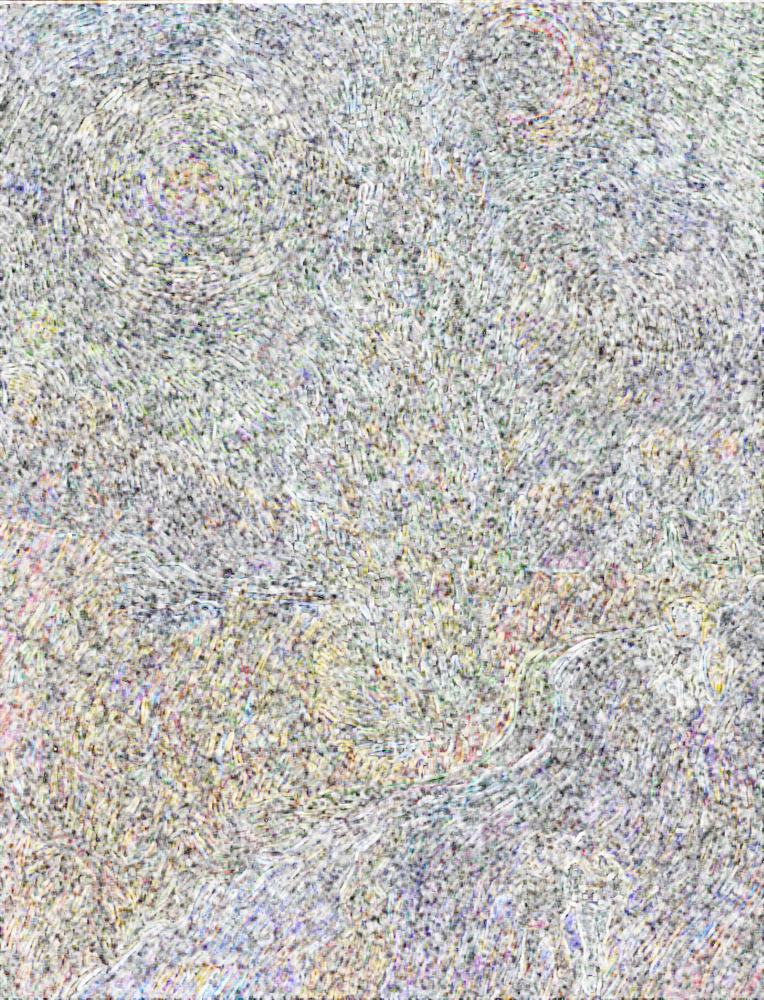

In [24]:
cv2_imshow(diff_square) # square spline

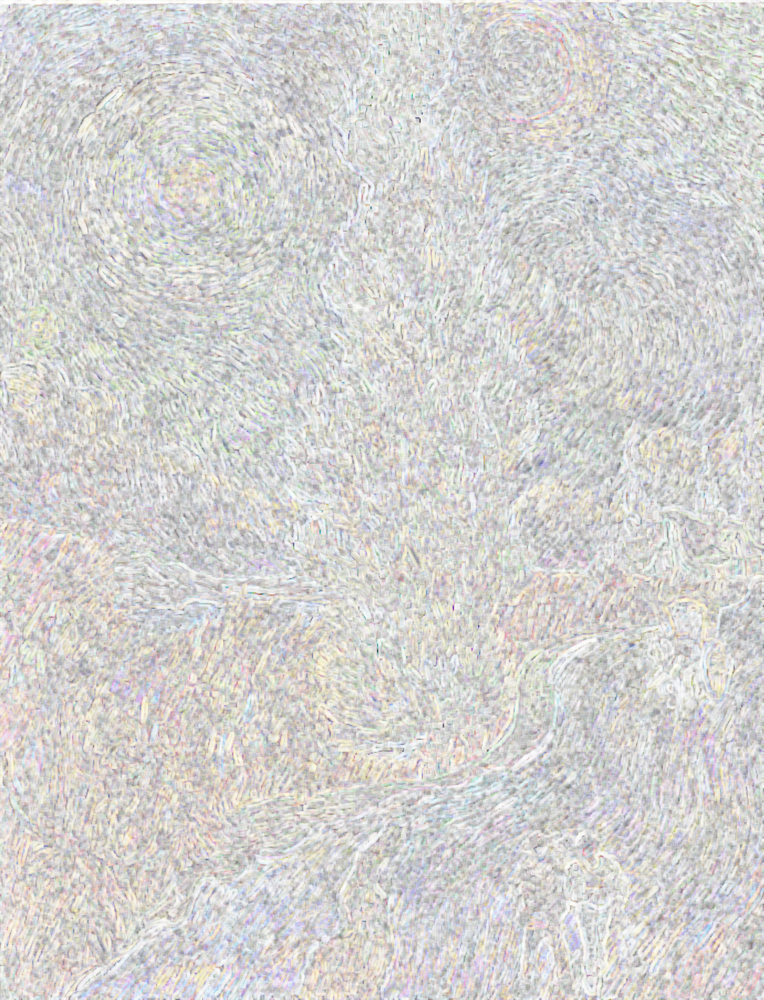

In [26]:
cv2_imshow(diff_errors) #spline difference

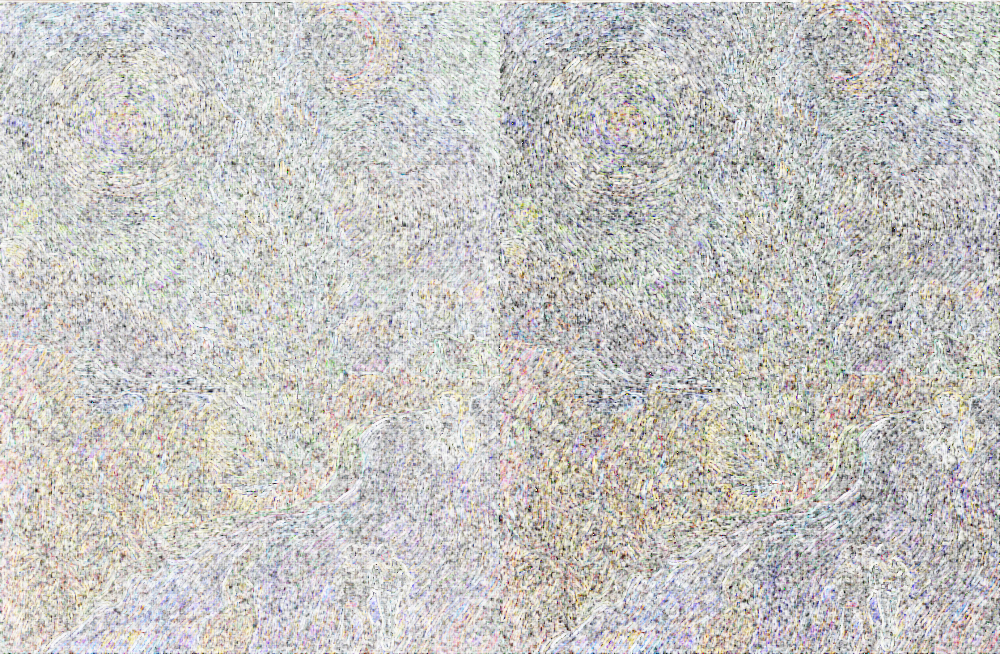

In [29]:
cv2_imshow(frame) # compare errors